# same with extractRrs.ipynb, but cleaned

In [1]:
#import
import pandas as pd
import numpy as np
from pyproj import Proj, Transformer
from concurrent import futures
import os
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
import rioxarray as rxr
from glob import glob

In [2]:
def readTif_onlyWater(path_to_image):
    """
    #read tif and extract water region by where(image>0)
    #this function also plot map
    args:
        path_to_image = "../satelliteImage/Sentinel2_L2A_MississippiS501.tif"
    return : 
        image : xarray object (水域以外は0)
    """
    image = rxr.open_rasterio(path_to_image)
    image = image.where(image>0, drop=True)
    #image.isel(band=0).plot() #6.0s

    return image

In [31]:
def latlon_to_xy(lat, lon):
    e2u_conv = Proj(proj = 'utm', zone =15, ellps = 'WGS84') 
    x,y  = e2u_conv(lon,lat) #lon:x lat:y
    return x, y

def tifPointsToxy(image):
    #xy座標への変換
    Lon,Lat  = np.meshgrid(image.x.values,image.y.values)

    e2u_conv = Proj(proj = 'utm', zone =15, ellps = 'WGS84') 
    utmx,utmy = e2u_conv(Lon,Lat)


    return utmx,utmy#x_points,y_points

In [4]:
def readRivCenterLine(path_to_RivCenterLine,clip=[38.60284134429668,38.99242639934311,-90.45334533854292,-90.04685118281743]):
    """
    csvファイルを読み込み、lat,lonをx,yに変換し、dfを返す
    filePath = "../dat_satellite/RivCenterLine_MS_sparse.csv"
    """
    ## read csv
    df = pd.read_csv(path_to_RivCenterLine)

    ## extract by clip
    df = df.query(f'{clip[0]}<latitude < {clip[1]} & {clip[2]}<longitude<{clip[3]}')
    df = df.reset_index(drop=True)

    x,y = latlon_to_xy(df["latitude"],df["longitude"])
    #points = np.array([[x0,y0] for x0,y0 in zip(x,y)])

    df["x"] = x
    df["y"] = y
    df.to_csv("../dat_satellite/RivCenterLine_MS_sparse_xy.csv")
    return df

In [5]:
def degToLatLon(hour,min,sec):
    return hour+min/60+sec/3600

In [7]:
def findNeighbors(points,centerpoint,k_neighbors=5,):
    """
    観測地点（河川のある一地点）から距離の近い点をK_neighbors個だけ選択する
    """
    nbrs = NearestNeighbors(n_neighbors=k_neighbors, algorithm='auto').fit(points)
    distances, indices = nbrs.kneighbors([centerpoint])
    indices = indices[0]

    return indices

In [13]:
def findQuadilateral_points(df,indices,buffer=100,width_ratio=0.7):
        
        df = df[df.index.isin(indices)]
        Quadilateral_points_series = []
        for index in indices:          
            ##set parameters
            theta = df["orthogonal"][index] #in radians
            w = df["width"][index] * width_ratio
            cos = np.cos(theta)
            sin = np.sin(theta)
            center = np.array([df["x"][index],df["y"][index]])
            #print(f"center={center}")
            ## determine the apex of the rectangular
            p1 = center + np.array([w*cos + buffer*sin, w*sin - buffer*cos])
            p2 = center + np.array([w*cos - buffer*sin, w*sin + buffer*cos])
            p3 = 2 * center - p1
            p4 = 2 * center - p2
            quadrilateral_points = [p1,p2,p3,p4]

            Quadilateral_points_series.append(quadrilateral_points)
        
        return Quadilateral_points_series

In [8]:

def point_in_quadrilateral_vectorized(x_points, y_points, quadrilateral_points):
    """
    ベクトル演算を使用して、四角形領域の内部に複数の点が存在するかどうかを判定する関数

    Parameters:
        x_points, y_points: テストする点の座標 (配列)
        quadrilateral_points: 四角形の頂点の座標 [(x1, y1), (x2, y2), (x3, y3), (x4, y4)]

    Returns:
        np.array: 各点が四角形の内部にあるかどうかを示すブール値の配列
    """
    # 四角形の各辺に対して、点が左側（外側）か右側（内側）にあるかを判定
    sides = np.array([
        (quadrilateral_points[i][0] - quadrilateral_points[i - 1][0]) * (y_points - quadrilateral_points[i - 1][1]) -
        (x_points - quadrilateral_points[i - 1][0]) * (quadrilateral_points[i][1] - quadrilateral_points[i - 1][1])
        for i in range(len(quadrilateral_points))
    ])

    # 各点が四角形の内部にあるかどうかを判定
    result = np.logical_or(np.all(sides >= 0, axis=0), np.all(sides <= 0, axis=0))

    return result

In [9]:
def spectrum_extract(image,boolMatrix):
    """
    boolMatrix=Trueの点のspectrumをListにして渡す
    """
    spectrum = []
    for y in range(len(image.y.values)):
        for x in range(len(image.x.values)):
            
            if boolMatrix[y,x]:#1376*1896
                spectrum.append(image[:,y,x].values)
    return spectrum

In [32]:
def findSpectrumInBuffer_iter(Quadilateral_points,path_to_image,buffer=100,width_ratio=0.7):
    date = path_to_image[-18:-13]
    print(f"task start:image:{date} \n")
    image = readTif_onlyWater(path_to_image)
    x_points,y_points = tifPointsToxy(image)#image.x.values,image.y.values
    #x_points,y_points = latlon_to_xy(Lat,Lon)
    
    # empty result list
    spectrum = []

    #start iteration for each index
    for i,points in enumerate(Quadilateral_points):
        result = point_in_quadrilateral_vectorized(x_points, y_points, points)
        
        ## add
        if result.any() == True:
            res = spectrum_extract(image,result)
            spectrum+=res
        else:
            pass

    if spectrum !=[]:
        fig,ax = plt.subplots()
        for i in spectrum:
            ax.plot([490,565,665,705,740,783,842,865],i)
        ax.set_title(date)
        fig.savefig(f"../png/MO_B8A/MO_B8A_{date}.png")

    return spectrum

In [21]:
def plot_spectrum(spectrumInBuffer):

    fig,ax  = plt.subplots()
    spectrum = []
    for res in spectrumInBuffer:
        ax.plot([490,565,665,705,740,783,842,865],res)
        spectrum.append(res)
    plt.show()
    return spectrum

In [22]:
def ave_spectrum(spectrum):
    ave = []
    for i in range(len(spectrum[0])):
        sum = 0
        for j in range(len(spectrum)):
            sum += spectrum[j][i]
        ave.append(sum/len(spectrum))
    return ave

In [23]:
def mainToAll(path_to_tiff_all,obsPoint):

    ##1.read variables that does not change during iteration
    print("reading df \n")
    path_to_RivCenterLine = "../dat_satellite/RivCenterLine_MS_sparse.csv"
    df = readRivCenterLine(path_to_RivCenterLine,clip=[38.60284134429668,38.99242639934311,-90.45334533854292,-90.04685118281743])

    ## find near points for observation point
    print("Finding quadilateral points \n")
    rivCenterPoints = np.array([[x0,y0] for x0,y0 in zip(df["x"],df["y"])])
    indices = findNeighbors(rivCenterPoints,obsPoint,k_neighbors=1)

    quadilateral_points = findQuadilateral_points(df,indices,buffer=100,width_ratio=0.7) #list of [[p1,p2,p3,p4],[p1,p2,p3,p4]...]
    
    ##2. start iteration for each image by multi processor
    print("Start iteration \n")
    future_list = []
    with futures.ProcessPoolExecutor(os.cpu_count()) as executor:
        for path in path_to_tiff_all:
            future = executor.submit(findSpectrumInBuffer_iter,quadilateral_points,path)
            future_list.append(future)

    result = [f.result() for f in future_list]

    return result

In [24]:
def removeOutlier(path_to_tiff_all,result,place):
    if isinstance(path_to_tiff_all, list):
    
        averaged_spectrum = []
        path_list = []
        for path,res in zip(path_to_tiff_all,result):
            if res != []:
                #print(res)
                data = pd.DataFrame(res,columns=["B2","B3","B4","B5","B6","B7","B8","B8A"])
                data = data.dropna()
                data = data.reset_index()
                q_upper = data.B7.quantile(0.90)
                q_lower = data.B7.quantile(0.10)
                new_data = data.query("@q_lower <B7 < @q_upper")

                fig,ax = plt.subplots()
                for i in range(len(new_data)):
                    ax.plot(new_data.iloc[i,1:])
                ax.set_title(path)
                plt.show()
                

                averaged = [np.average(new_data.iloc[:,i]) for i in range(1,9)]
                path_list.append(path[46:51])
                averaged_spectrum.append(averaged)  
        averaged_df = pd.DataFrame(averaged_spectrum,columns=["B2","B3","B4","B5","B6","B7","B8","B8A"])
        averaged_df["date"] = path_list
        averaged_df.to_csv(f"../dat_satellite/csv/S2L2A_SL_B8A_{place}2019.csv")
    return averaged_spectrum


### 実行

In [25]:
MO = [degToLatLon(38.,47.,13.9), degToLatLon(-90.,-28.,-18.5)]
MO = latlon_to_xy(MO[0], MO[1])

MS_upper = [degToLatLon(38.,57.,4.), degToLatLon(-90.,-22.,-16)]
MS_upper = latlon_to_xy(MS_upper[0], MS_upper[1])

#MS_lower = [degToLatLon(38.,57.,4.), degToLatLon(-90.,-22.,-16)]
MS_lower = [38.143648,-90.254995]#
MS_lower = latlon_to_xy(MS_upper[0], MS_upper[1])

reading df 

Finding quadilateral points 

Start iteration 

task start:image:07-13 
task start:image:03-05 
task start:image:09-11 
task start:image:11-27 



task start:image:12-22 

task start:image:10-01 

task start:image:01-09 


task start:image:07-08 
task start:image:10-08 
task start:image:08-02 
task start:image:11-10 
task start:image:09-18 
task start:image:07-18 
task start:image:08-04 
task start:image:06-10 
task start:image:06-05 
task start:image:08-04 
task start:image:08-19 
task start:image:06-25 


task start:image:10-23 




task start:image:3-04- 

task start:image:09-26 





task start:image:3-05- 

task start:image:09-16 
task start:image:07-13 
task start:image:08-04 
task start:image:02-08 

task start:image:10-23 
task start:image:01-29 
task start:image:0-04- 
task start:image:04-26 

task start:image:07-30 

task start:image:12-05 
task start:image:09-23 
task start:image:1-05- 

task start:image:07-20 





task start:image:12-07 
task start:image:07-25

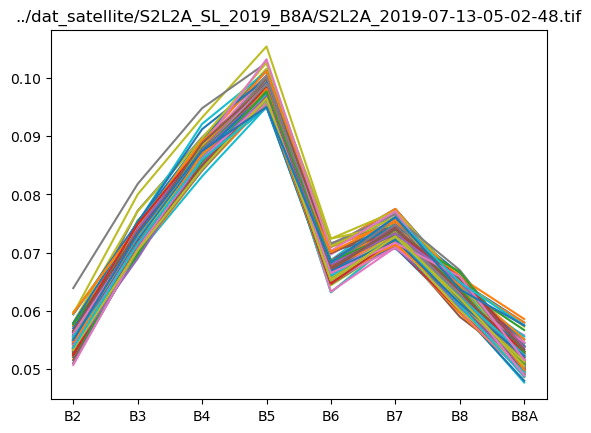

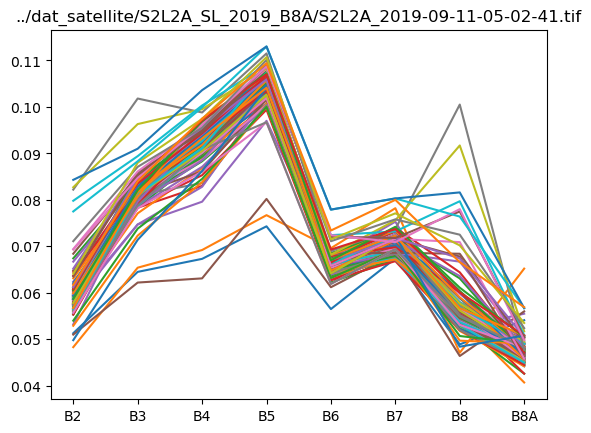

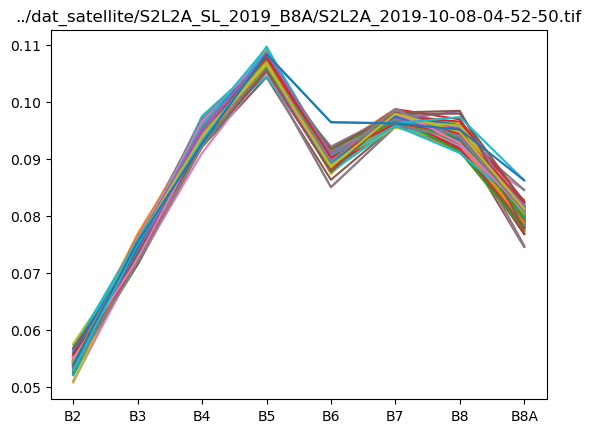

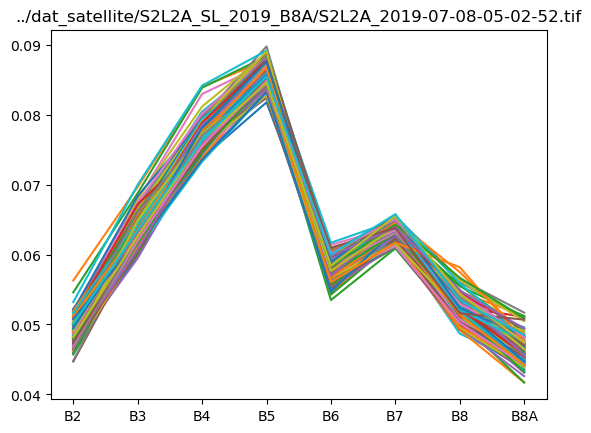

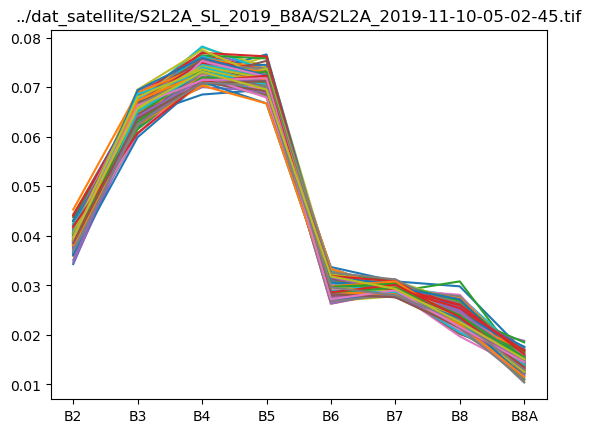

...

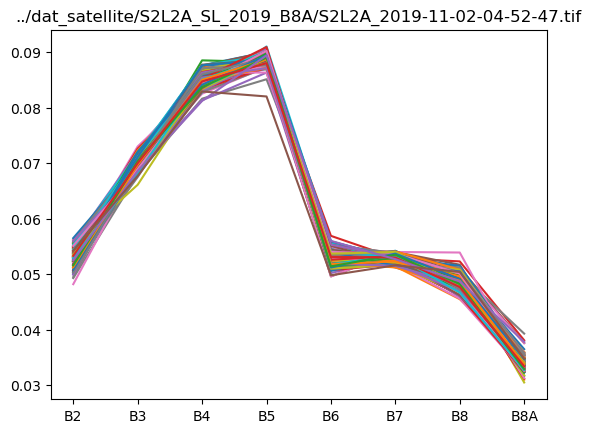

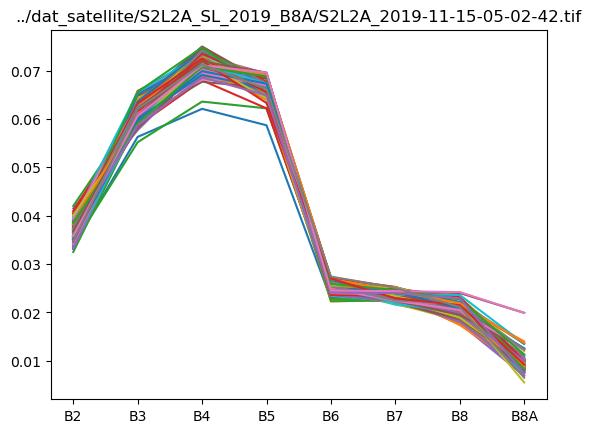

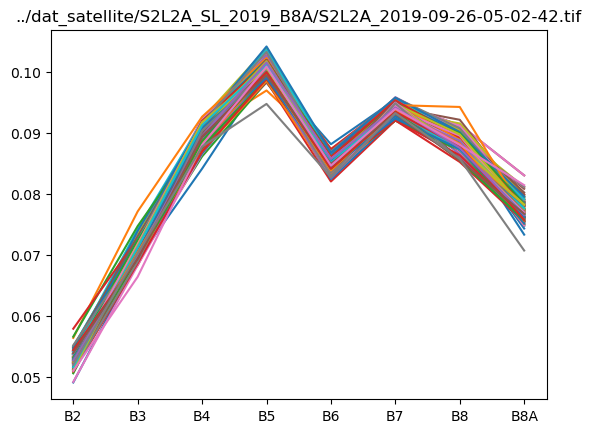

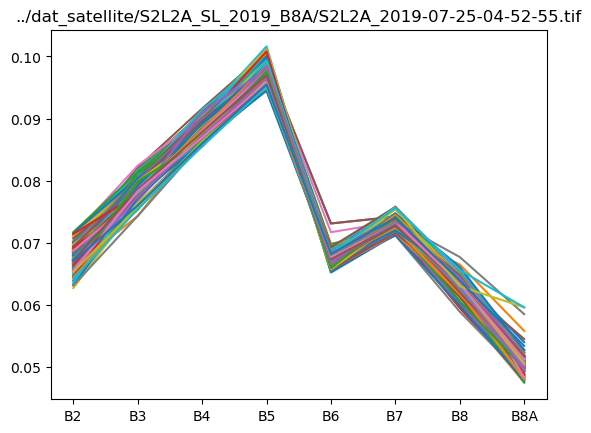

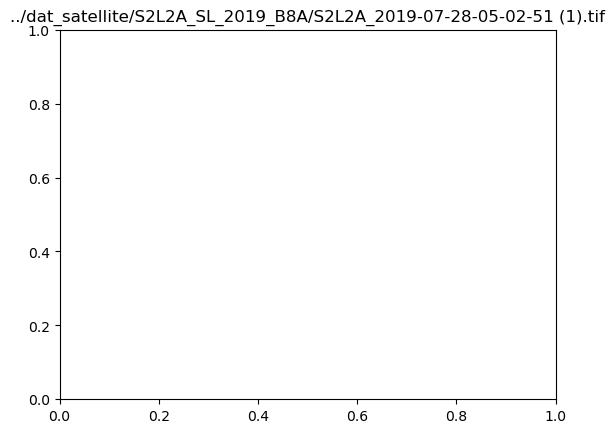

/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


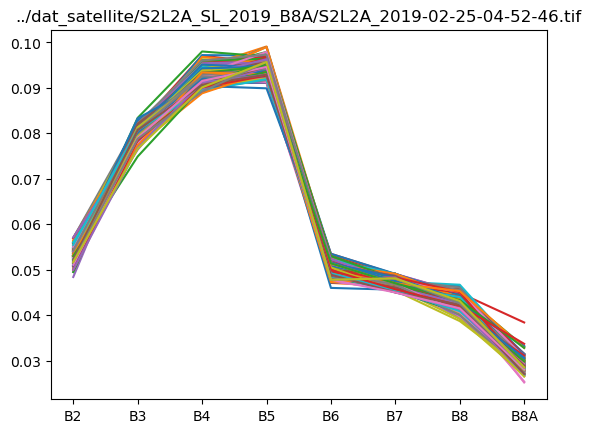

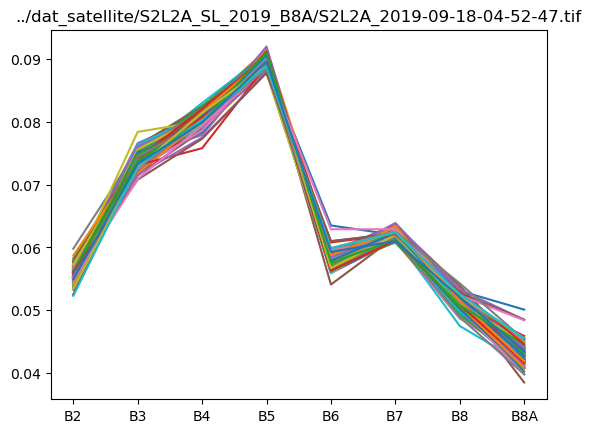

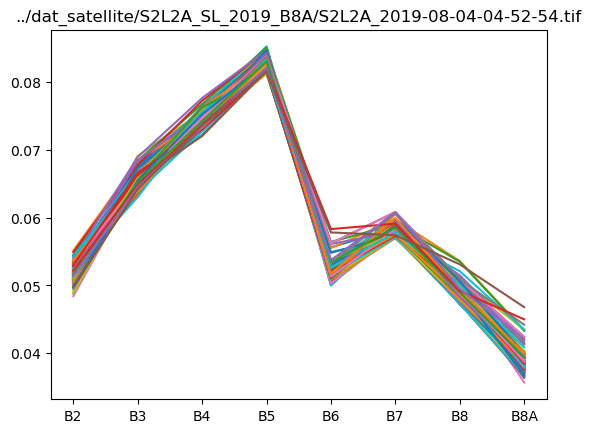

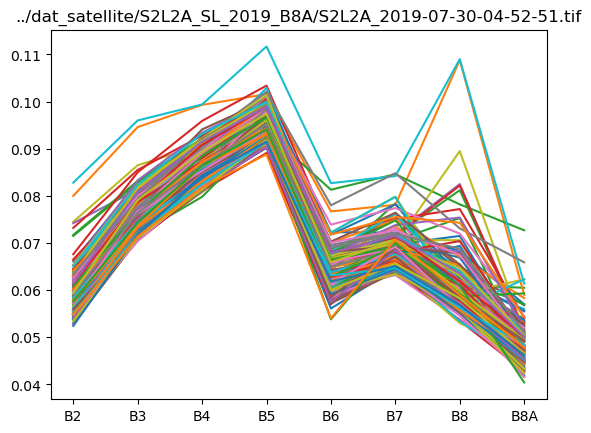

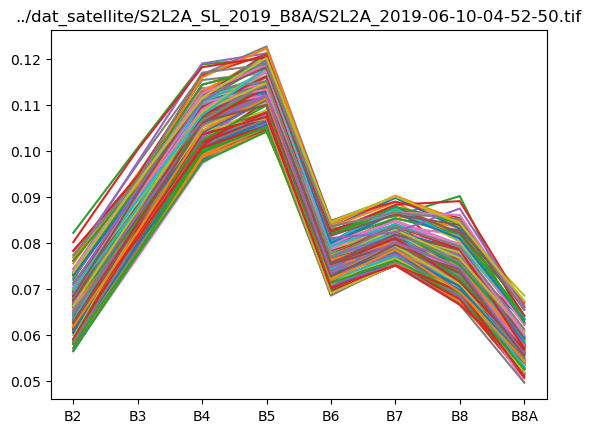

...

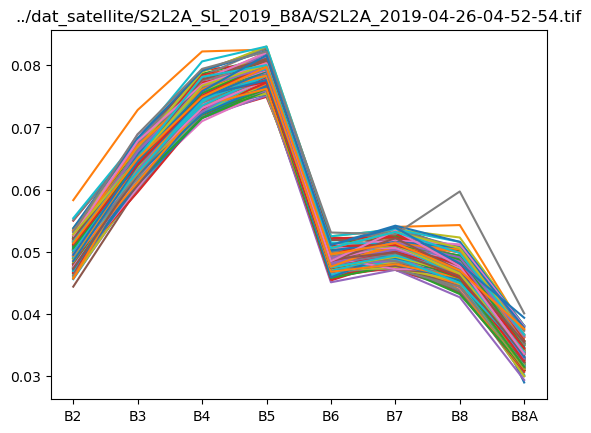

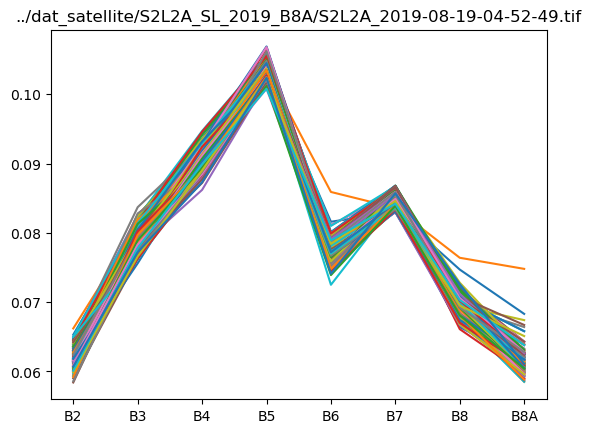

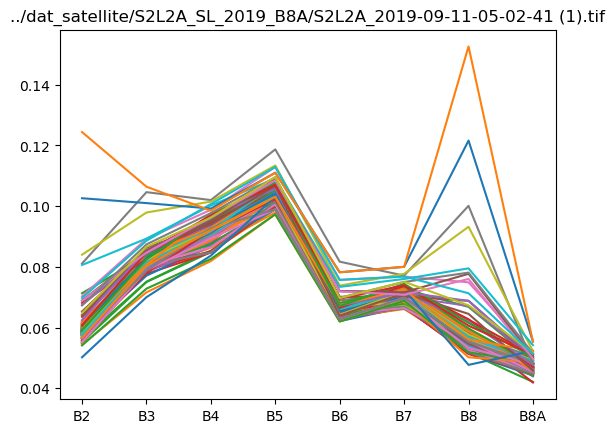

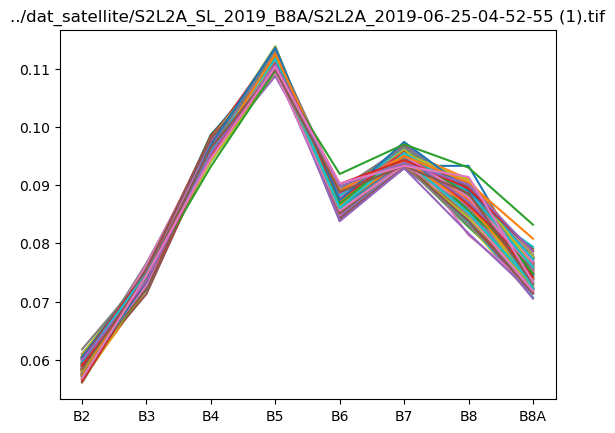

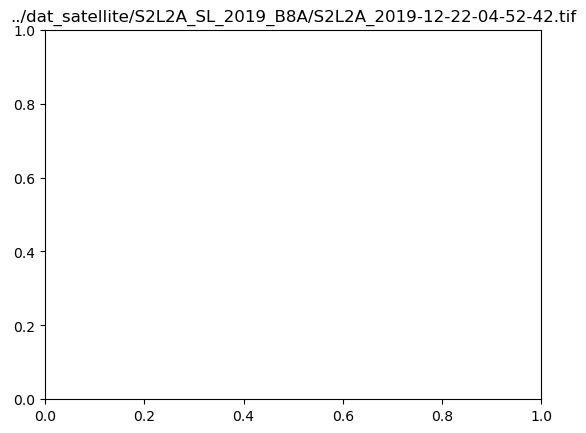

/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


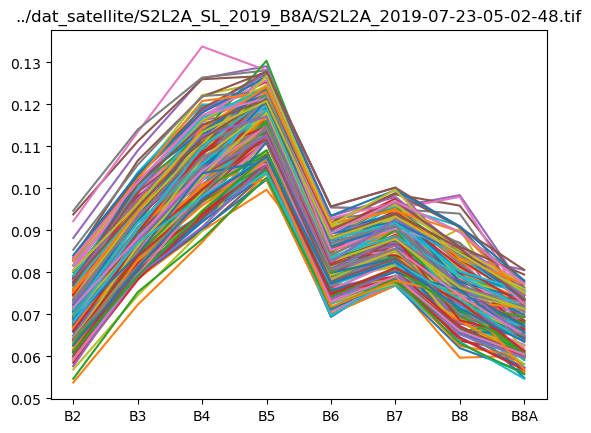

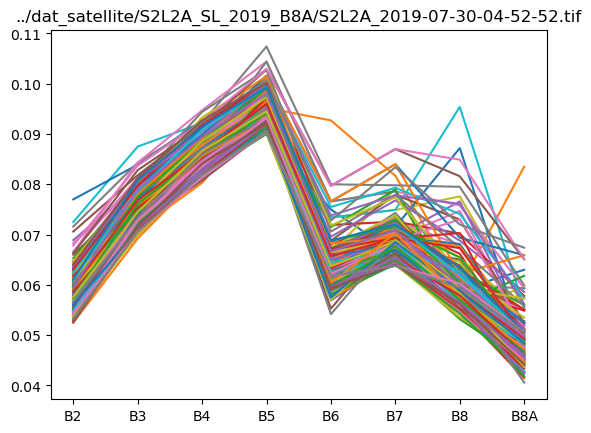

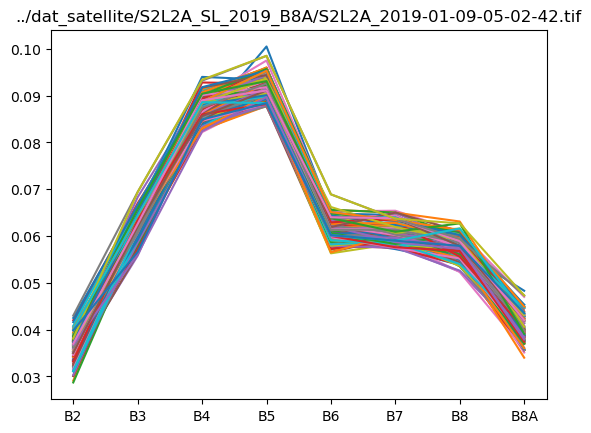

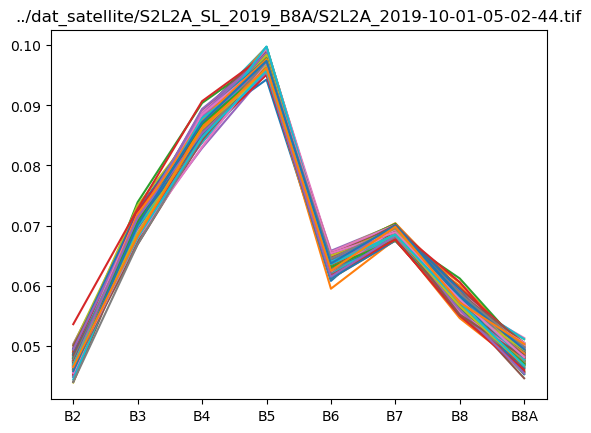

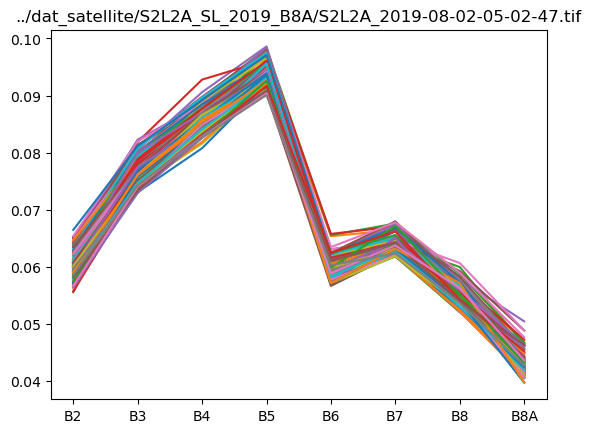

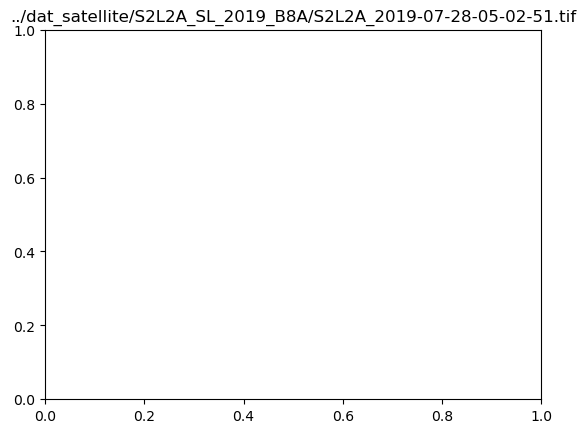

/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


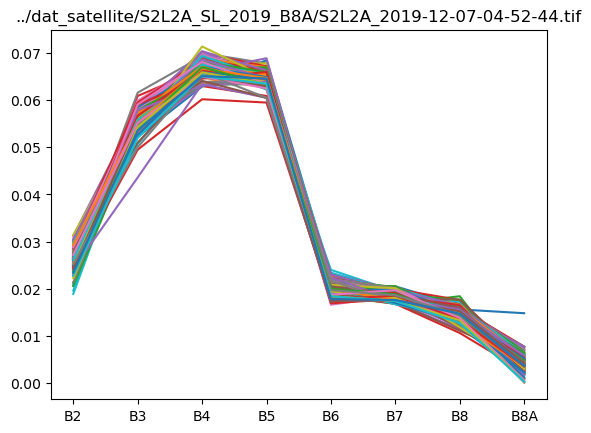

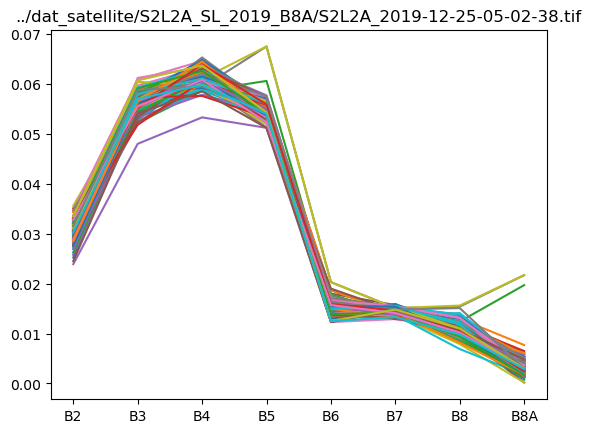

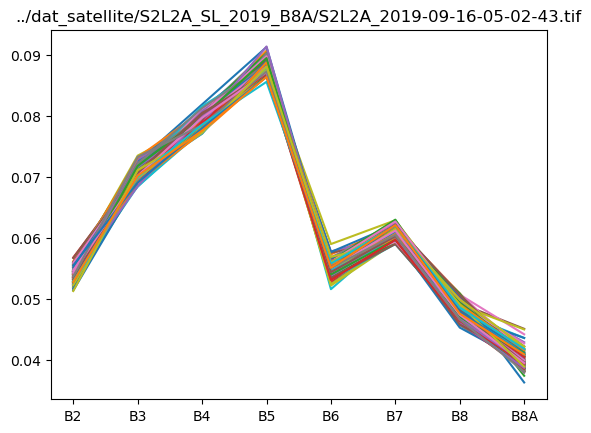

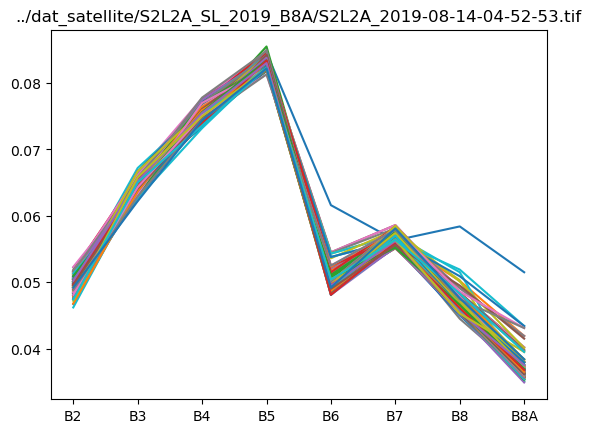

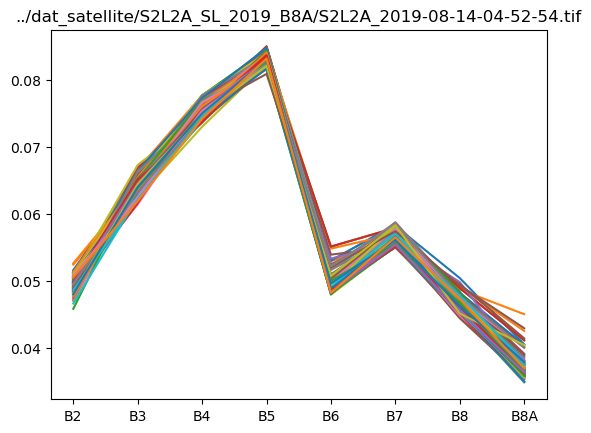

...

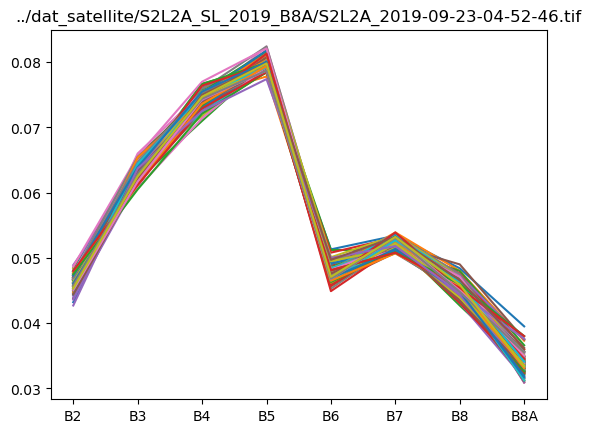

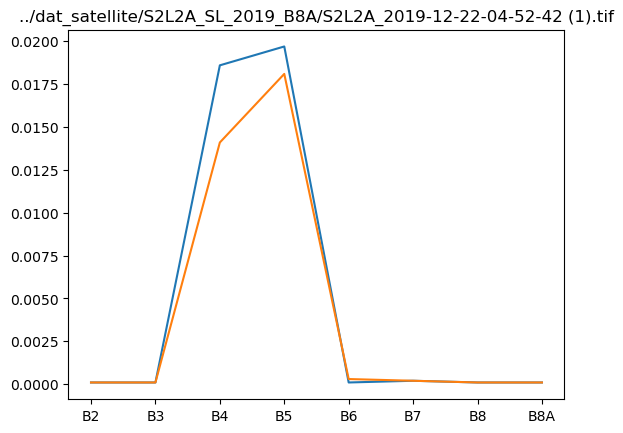

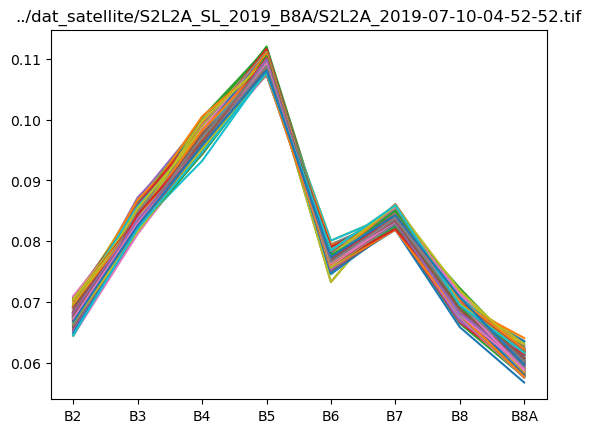

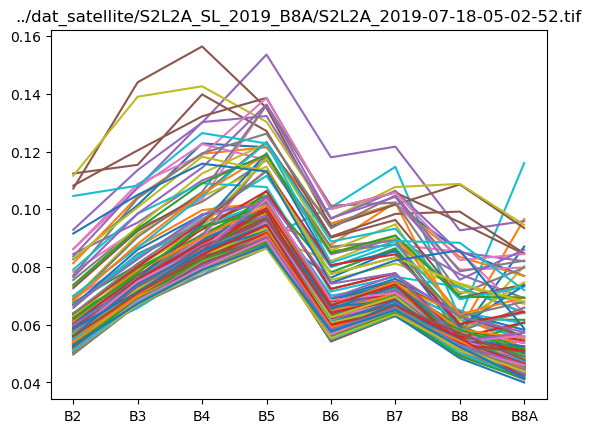

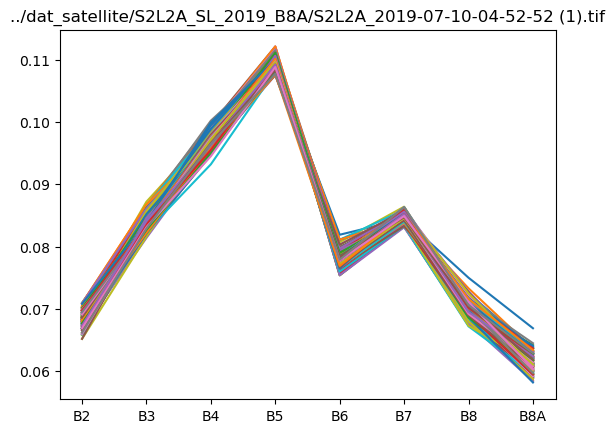

In [34]:
path_to_tiff_all = glob("../dat_satellite/S2L2A_SL_2019_B8A/S2L2A_*.tif")
result = mainToAll(path_to_tiff_all[:],MO)
res = removeOutlier(path_to_tiff_all[:],result,"MO")

reading df 

Finding quadilateral points 

Start iteration 

task start:image:07-13 
task start:image:03-05 

task start:image:09-11 
task start:image:11-27 
task start:image:10-01 


task start:image:01-09 


task start:image:12-22 
task start:image:08-02 



task start:image:10-08 

task start:image:06-05 
task start:image:09-18 
task start:image:07-08 
task start:image:11-10 
task start:image:06-10 

task start:image:08-04 
task start:image:08-04 


task start:image:07-18 
task start:image:06-25 

task start:image:3-04- 
task start:image:07-13 
task start:image:07-30 


task start:image:12-07 
task start:image:10-23 
task start:image:08-19 
task start:image:09-16 
task start:image:08-04 
task start:image:0-04- 
task start:image:09-26 
task start:image:02-08 
task start:image:09-06 
task start:image:07-20 

task start:image:3-05- 

task start:image:1-05- 

task start:image:01-29 

task start:image:12-05 
task start:image:04-26 
task start:image:09-23 
task start:image:11-02 


task s

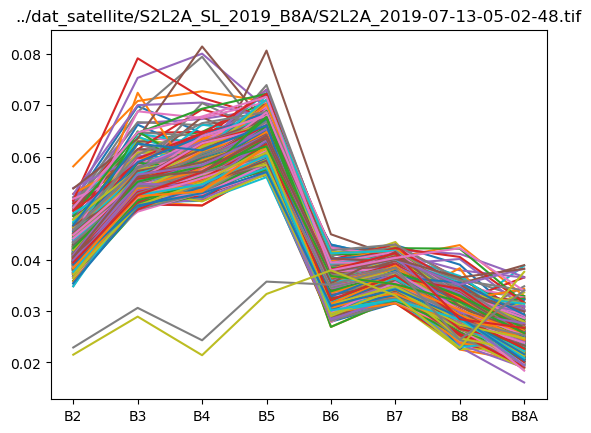

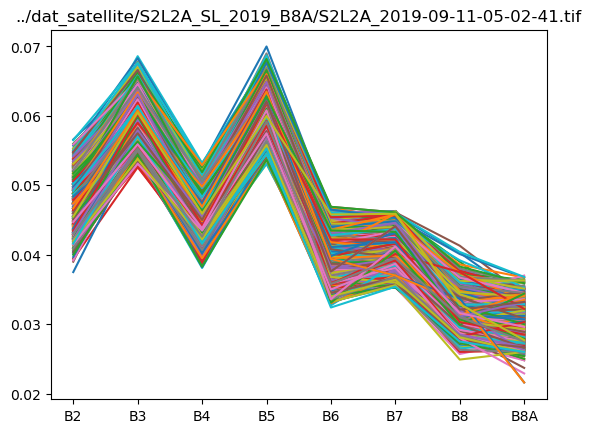

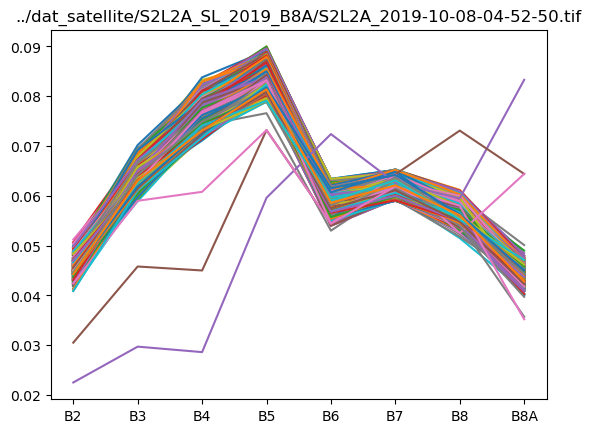

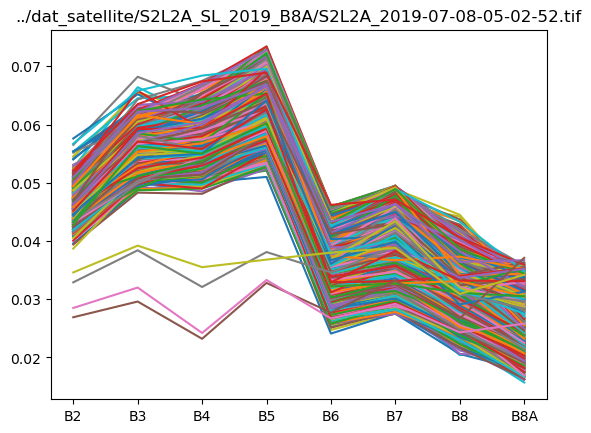

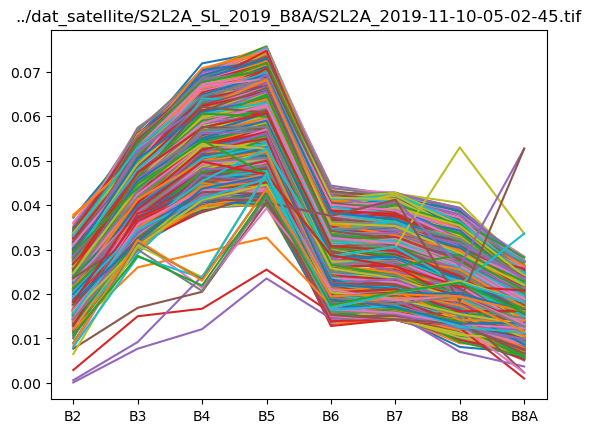

...

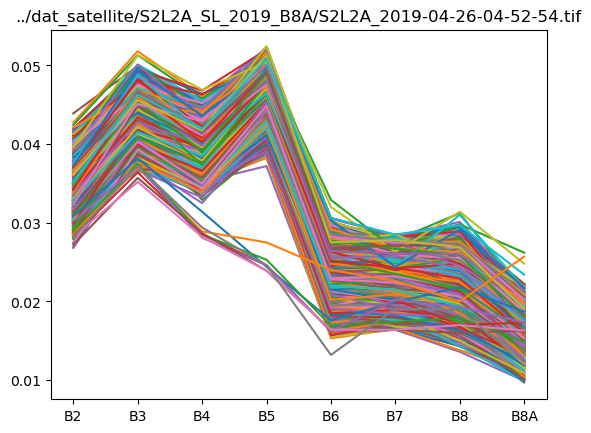

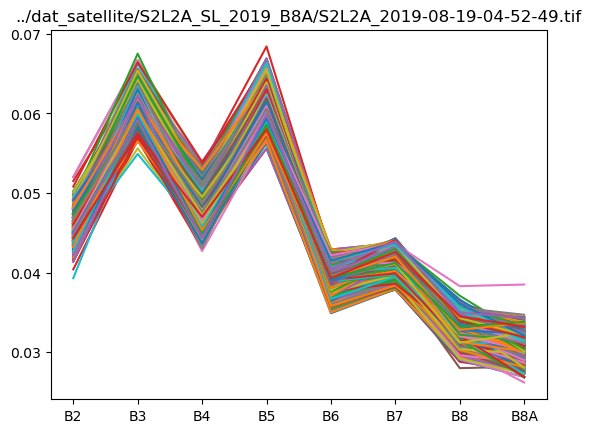

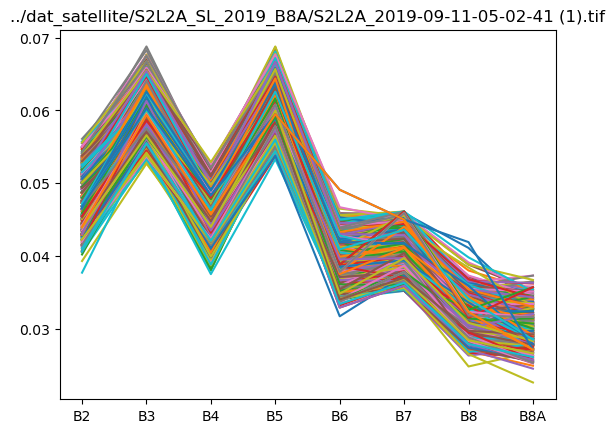

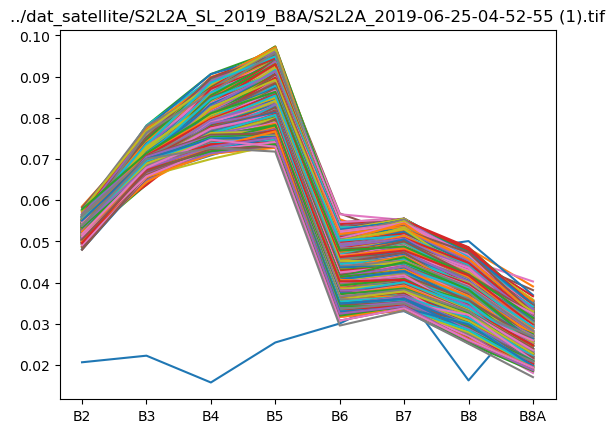

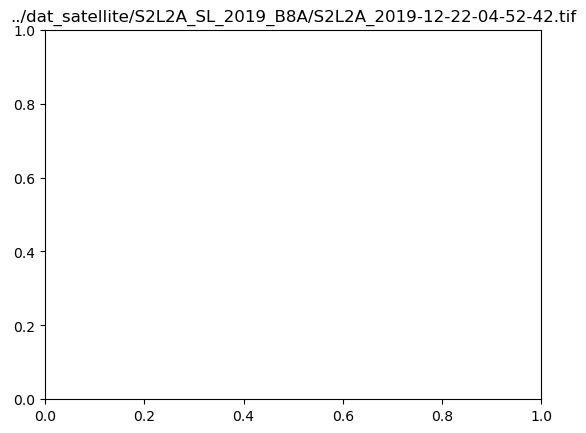

/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


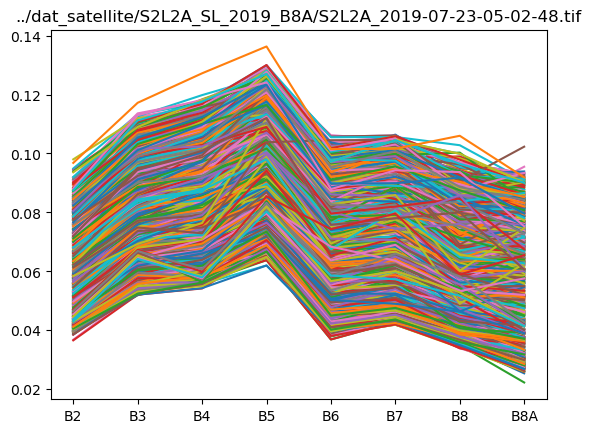

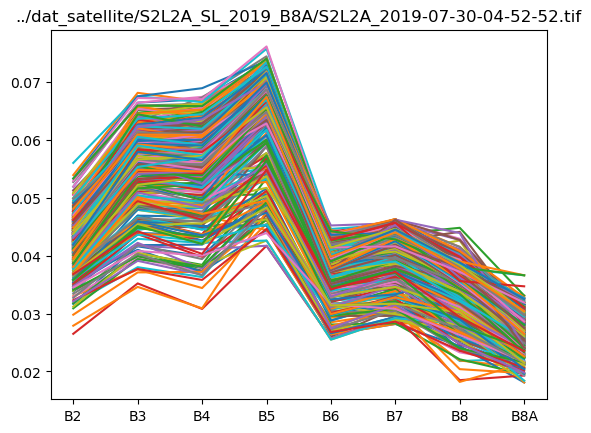

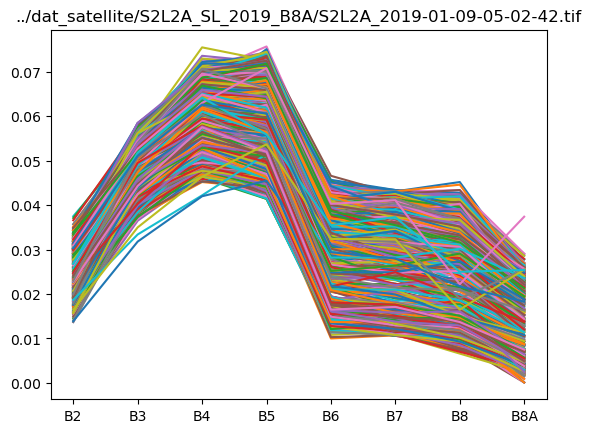

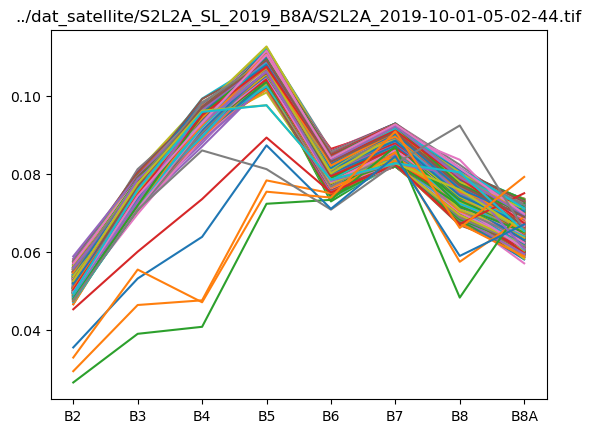

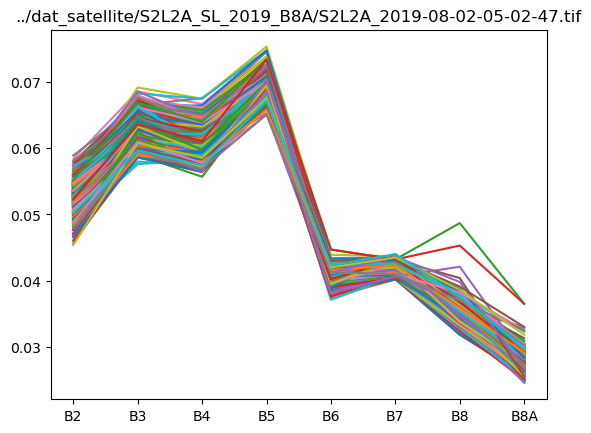

...

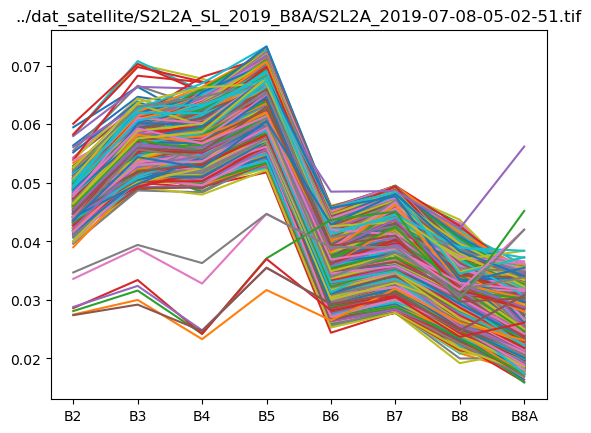

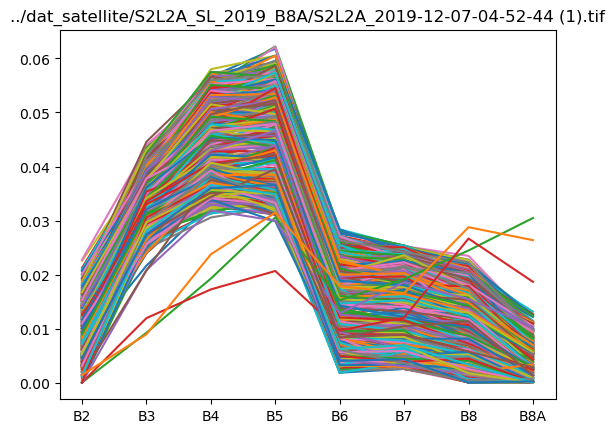

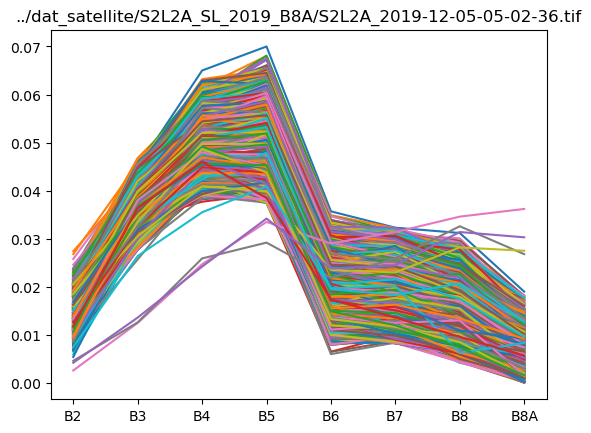

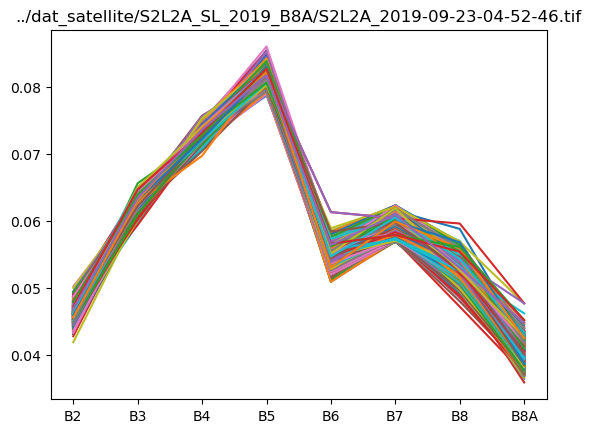

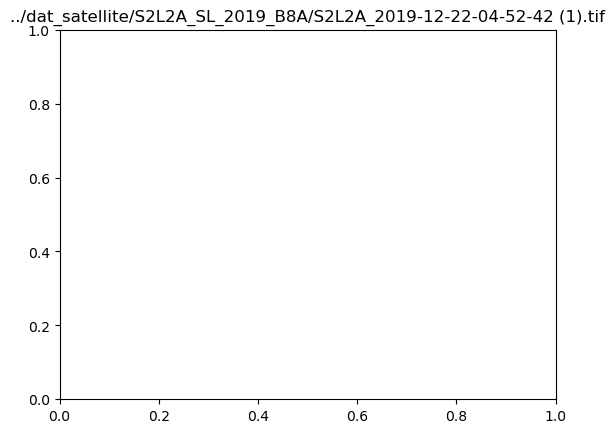

/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/k-ishida/miniconda3/envs/jupyter/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


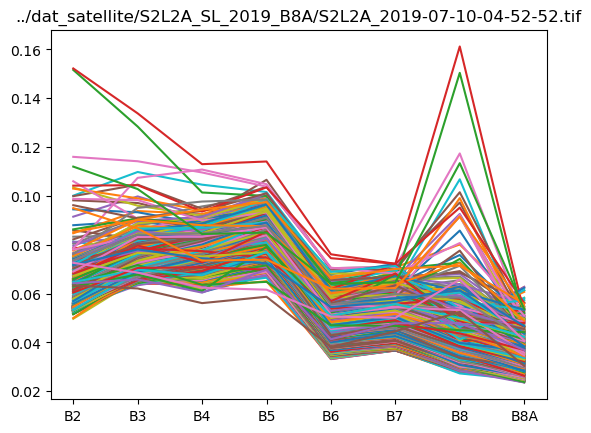

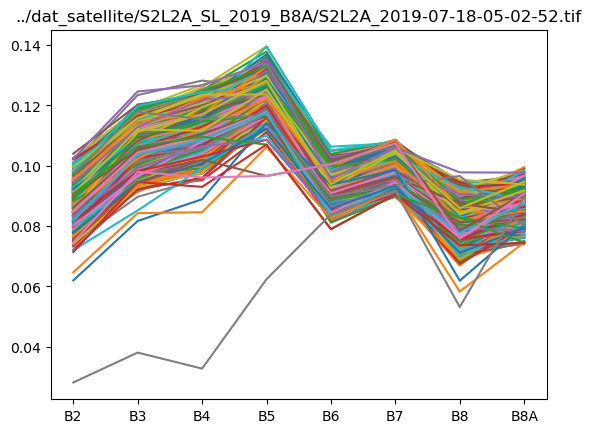

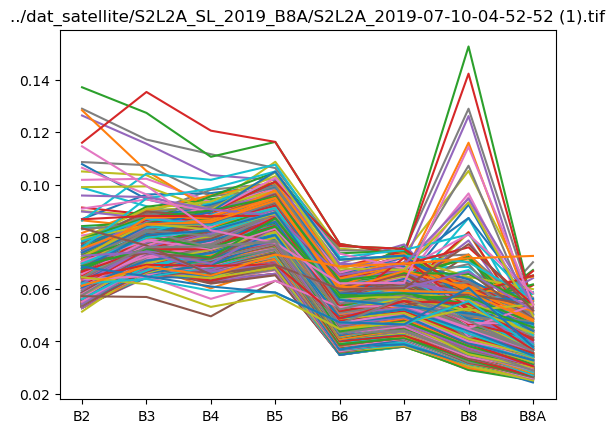

In [35]:
path_to_tiff_all = glob("../dat_satellite/S2L2A_SL_2019_B8A/S2L2A_*.tif")
result = mainToAll(path_to_tiff_all[:],MS_upper)
res = removeOutlier(path_to_tiff_all[:],result,"MSupper")

In [36]:
path_to_tiff_all = glob("../dat_satellite/S2L2A_SL_2019_B8A/S2L2A_*.tif")
result = mainToAll(path_to_tiff_all[:],MS_lower)
res = removeOutlier(path_to_tiff_all[:],result,"MSlower")

reading df 

Finding quadilateral points 



ValueError: Input X contains infinity or a value too large for dtype('float64').